In [1]:
import os
import re
import glob
import time
import numpy as np
from tqdm import tqdm
from collections import defaultdict, Counter
import sentencepiece as spm
import matplotlib.pyplot as plt
from Bio.Seq import Seq
from Bio import SeqIO
import pandas as pd
import subprocess
import psutil
import networkx as nx
from Levenshtein import distance as levenshtein_distance
import seaborn as sns

In [2]:
"""Notes:
This notebook is a bit of a rough draft. It is going to take a long time to do all the organisms and run it for all the tokens.(I tried
and it took hours and still wasn't finished so I just used limited number of tokens from the vocab.Maybe in the future we can find a more 
efficient way or just be very patient) 
I took the optimal vocab for ecoli from the sp_bpe_kmer.ipnb notebook and used it to run this notebook. 

Below are some relevant reading materials I used that you might find interesting. 
"""
# https://en.wikipedia.org/wiki/Needleman%E2%80%93Wunsch_algorithm
# https://en.wikipedia.org/wiki/Smith%E2%80%93Waterman_algorithm#:~:text=The%20Smith%E2%80%93Waterman%20algorithm%20performs,acid%20sequences%20or%20protein%20sequences.
# 


"Notes:\nThis notebook is a bit of a rough draft. It is going to take a long time to do all the organisms and run it for all the tokens.(I tried\nand it took hours and still wasn't finished so I just used limited number of tokens from the vocab.Maybe in the future we can find a more \nefficient way or just be very patient) \nI took the optimal vocab for ecoli from the sp_bpe_kmer.ipnb notebook and used it to run this notebook. \n\nBelow are some relevant reading materials I used that you might find interesting. \n"

In [3]:

tokenizers_dir = "/Users/tiananoll-walker/Documents/biotokens/tokenizers"

def load_vocab(org, vocab_size):
    vocab_path = os.path.join(tokenizers_dir, f"{org}_{vocab_size}.vocab")
    with open(vocab_path, 'r') as f:
        vocab = [line.split('\t')[0] for line in f.readlines()[3:]] 
    return vocab

org = "e_coli_genome"
vocab_size = 37000

tokens = load_vocab(org, vocab_size)

In [4]:
"""the levenshtein distance is a metric for measuring the dif between 2 sequences. it counts the min number of single character edits required tot change one word into the other.
in our fitness landscape analysis, we use levenshtein distance to determine how closely related dif tokens are. by constructing a graph where nodes are tokens and edges exist between
nodes that are levenshtein distance 1 apart, we can visualize and analyze the relationship between tokens"""

def levenshtein_distance(seq1, seq2):
    # if length of seq1 is less than seq2, swaparoo
    if len(seq1) < len(seq2):
        return levenshtein_distance(seq2, seq1)
    # if seq2 is empty, return the len of seq1
    if len(seq2) == 0:
        return len(seq1)
    # create range obj for the prev row
    previous_row = range(len(seq2) + 1)
    # iterate over chars in seq1
    for i, c1 in enumerate(seq1):
        current_row = [i + 1]
        # iterate over chars in seq2
        for j, c2 in enumerate(seq2):
            # calculate insertions, deletions, and subs
            insertions = previous_row[j + 1] + 1
            deletions = current_row[j] + 1
            substitutions = previous_row[j] + (c1 != c2)
            # append the min of these vals to the current row
            current_row.append(min(insertions, deletions, substitutions))
        # update prev row to be the current row
        previous_row = current_row
    # return the last val in the prev row
    return previous_row[-1]

def build_levenshtein_graph(tokens, max_tokens=1000):
    G = nx.Graph()
    limited_tokens = tokens[:max_tokens]
    for token in limited_tokens:
        G.add_node(token)
    for i, token1 in enumerate(limited_tokens):
        for j in range(i + 1, len(limited_tokens)):
            token2 = limited_tokens[j]
            if levenshtein_distance(token1, token2) == 1:
                G.add_edge(token1, token2)
    return G

# limit the number of tokens for performance reasons
limited_tokens = tokens[:1000]

# perform levenshtein graph analysis
levenshtein_graph = build_levenshtein_graph(limited_tokens)
print(f"levenshtein graph has {len(levenshtein_graph.nodes)} nodes and {len(levenshtein_graph.edges)} edges")

levenshtein graph has 1000 nodes and 6775 edges


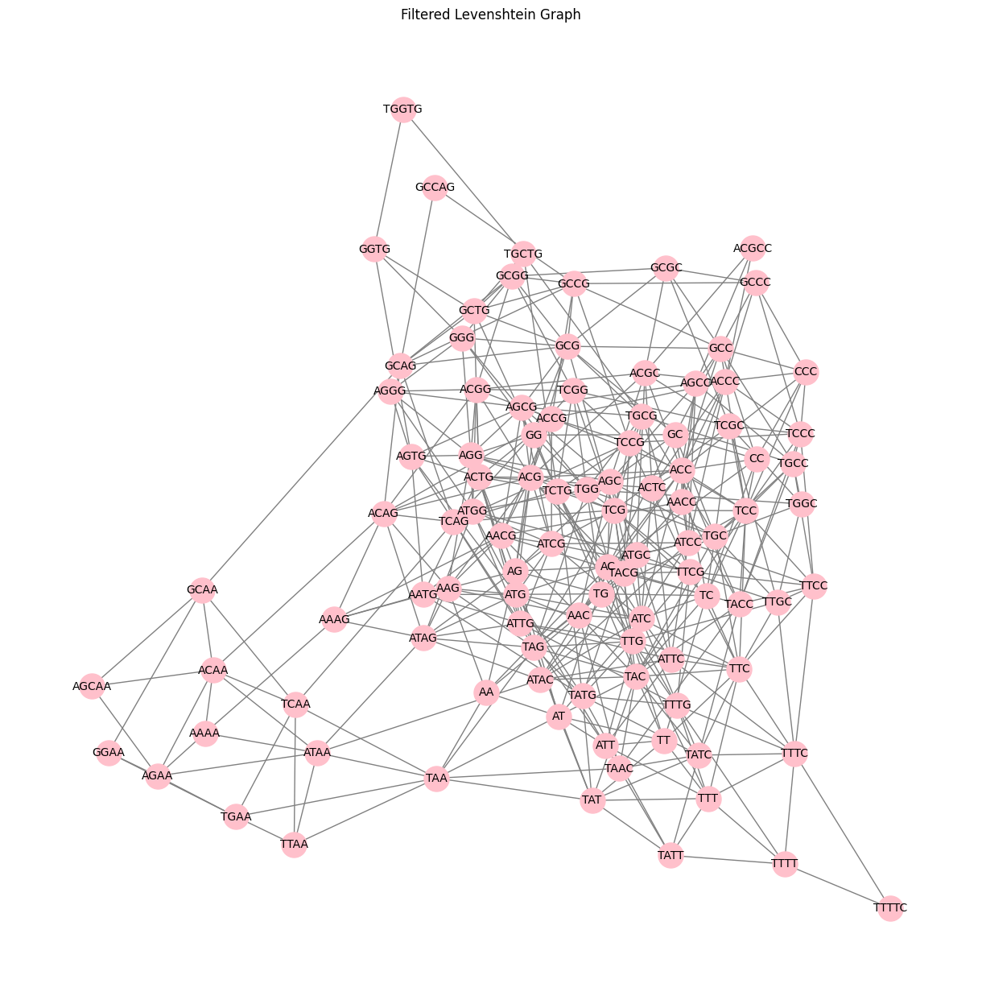

In [16]:
import networkx as nx
import matplotlib.pyplot as plt

def build_and_visualize_graph(tokens, threshold=5):
    G = nx.Graph()
    #limited_tokens = tokens[689:794]
    #limited_tokens = tokens[:100]
    #limited_tokens = tokens[16524:16945]
    #limited_tokens = tokens[3200:3400]
    limited_tokens = tokens[:100]
    for token in limited_tokens:
        G.add_node(token)
    for i, token1 in enumerate(limited_tokens):
        for j in range(i + 1, len(limited_tokens)):
            token2 = limited_tokens[j]
            if levenshtein_distance(token1, token2) == 1:
                G.add_edge(token1, token2)

    filtered_nodes = [node for node, degree in dict(G.degree()).items() if degree >= threshold]
    G_filtered = G.subgraph(filtered_nodes)

    plt.figure(figsize=(12, 12))
    pos = nx.spring_layout(G_filtered)
    nx.draw(G_filtered, pos, with_labels=True, node_size=500, font_size=10, node_color='pink', font_color='black', edge_color='gray')
    plt.title("Filtered Levenshtein Graph")
    plt.show()

build_and_visualize_graph(tokens, threshold=2)

In [17]:
"""centrality measures help identify the most important nodes in a network. we can use these measures to analyze the role/importance of each token in the fitness landscape."""

def compute_centrality_measures(G):
    centrality_measures = {
        "degree_centrality": nx.degree_centrality(G),
        "closeness_centrality": nx.closeness_centrality(G),
        "betweenness_centrality": nx.betweenness_centrality(G),
        "eigenvector_centrality": nx.eigenvector_centrality(G),
    }
    return centrality_measures

centrality_measures = compute_centrality_measures(levenshtein_graph)
for measure, values in centrality_measures.items():
    print(f"{measure}:")
    for node, value in values.items():
        print(f"{node}: {value:.4f}")
    print()

degree_centrality:
GC: 0.0080
TT: 0.0080
AA: 0.0060
TC: 0.0110
AC: 0.0120
TG: 0.0100
GG: 0.0070
AG: 0.0110
GCC: 0.0130
ATC: 0.0170
ATT: 0.0090
AT: 0.0080
AAC: 0.0130
GCG: 0.0140
ACC: 0.0180
TTC: 0.0170
ATG: 0.0180
AGC: 0.0160
TGC: 0.0170
TGG: 0.0170
AGG: 0.0170
TAA: 0.0100
CC: 0.0080
ACG: 0.0180
TTG: 0.0170
AAG: 0.0150
TCC: 0.0180
TCG: 0.0180
TAC: 0.0180
TGCC: 0.0210
AAAA: 0.0070
GCGC: 0.0180
AGCC: 0.0190
GCTG: 0.0180
GGG: 0.0100
AACC: 0.0150
TTTT: 0.0080
AGCG: 0.0220
ATCC: 0.0210
ATTC: 0.0210
ATCG: 0.0220
ACCG: 0.0250
TTTC: 0.0230
GCAA: 0.0120
ATAA: 0.0160
ATTG: 0.0220
AACG: 0.0200
TTCC: 0.0210
GCGG: 0.0200
GCAG: 0.0180
GCCC: 0.0170
TTT: 0.0100
TGAA: 0.0150
GCCG: 0.0200
ATGG: 0.0210
ACCC: 0.0220
AGAA: 0.0160
TTTG: 0.0230
TGCG: 0.0230
ACTG: 0.0220
TATT: 0.0120
TAG: 0.0180
ACGG: 0.0240
ACGC: 0.0230
TTAA: 0.0140
ACAA: 0.0160
TATC: 0.0200
ATGC: 0.0210
TTCG: 0.0220
TGGC: 0.0150
TACC: 0.0210
TAAC: 0.0180
TAT: 0.0110
TCAA: 0.0150
TCAG: 0.0230
TTGC: 0.0200
ACAG: 0.0230
TCTG: 0.0220
TCCC: 0.02

In [18]:
"""community detection algos find groups of nodes that are more densely connected to each other than to other nodes. used to identify clusters of related tokens"""

def detect_communities(G):
    communities = list(nx.algorithms.community.greedy_modularity_communities(G))
    return communities

communities = detect_communities(levenshtein_graph)
print(f"detected {len(communities)} communities:")
for i, community in enumerate(communities):
    print(f"community {i + 1}: {sorted(community)}")

detected 7 communities:
community 1: ['AAAAAC', 'AAAATC', 'AAC', 'AACAAC', 'AACAC', 'AACACC', 'AACAGC', 'AACATC', 'AACC', 'AACCC', 'AACGC', 'AACGCC', 'AACTC', 'AACTGC', 'AACTGGC', 'AACTTC', 'AAGAAC', 'AAGATC', 'AC', 'ACAAC', 'ACAACC', 'ACAC', 'ACACC', 'ACAGC', 'ACAGCC', 'ACATC', 'ACATCC', 'ACATTC', 'ACC', 'ACCAAC', 'ACCAC', 'ACCACC', 'ACCAGC', 'ACCATC', 'ACCC', 'ACCCC', 'ACCGC', 'ACCGCC', 'ACCTGC', 'ACCTTC', 'ACGAC', 'ACGACC', 'ACGATC', 'ACGC', 'ACGCC', 'ACGCCC', 'ACGCGC', 'ACGGC', 'ACGTC', 'ACGTTC', 'ACTAC', 'ACTC', 'ACTCC', 'ACTGC', 'ACTGCC', 'ACTGGC', 'ACTTC', 'ACTTCC', 'ACTTTC', 'AGAAC', 'AGAC', 'AGATC', 'AGC', 'AGCAAC', 'AGCAC', 'AGCACC', 'AGCAGC', 'AGCATC', 'AGCC', 'AGCCC', 'AGCCCC', 'AGCGC', 'AGCGCC', 'AGCTC', 'AGCTGC', 'AGCTTC', 'AGGAAC', 'AGGATC', 'AGGC', 'AGGTC', 'AGTC', 'AGTTC', 'ATAAC', 'ATAACC', 'ATAACCC', 'ATAC', 'ATACC', 'ATACCC', 'ATACGC', 'ATAGC', 'ATAGCC', 'ATATAC', 'ATATC', 'ATATCC', 'ATATGC', 'ATATTC', 'ATATTCC', 'ATC', 'ATCAAC', 'ATCAC', 'ATCACC', 'ATCAGC', 'ATCATC

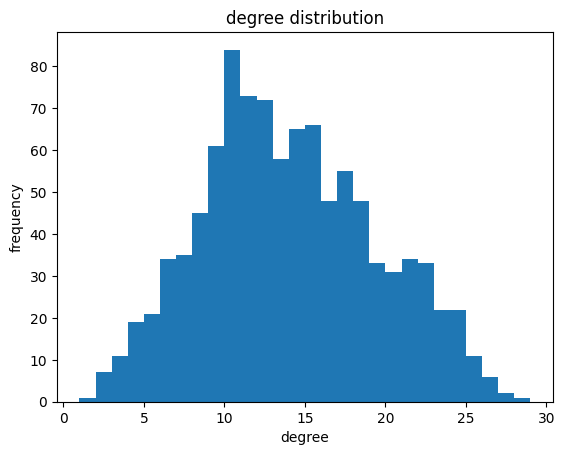

In [19]:
"""degree distribution shows how many connections (edges) each node has. we use this to understand the connectivity of the tokens"""
#degree : num of edges connected to a node
#frequency : number of nodes w that degree

def plot_degree_distribution(G):
    degrees = [G.degree(n) for n in G.nodes()]
    plt.figure()
    plt.hist(degrees, bins=range(1, max(degrees)+1))
    plt.title("degree distribution")
    plt.xlabel("degree")
    plt.ylabel("frequency")
    plt.show()

plot_degree_distribution(levenshtein_graph)

In [20]:
"""path lengths measure the shortest paths between nodes in the graph. so distance of 1 is a direct neighbor, 2 is two doors down, more than 2 means there are multiple intermediary tokens required to connect them  """

def compute_path_lengths(G):
    path_lengths = dict(nx.all_pairs_shortest_path_length(G))
    return path_lengths

path_lengths = compute_path_lengths(levenshtein_graph)
print(f"computed path lengths for {len(path_lengths)} nodes:")
for node, lengths in path_lengths.items():
    print(f"{node}: {lengths}")

computed path lengths for 1000 nodes:
GC: {'GC': 0, 'GCG': 1, 'TGC': 1, 'AC': 1, 'TC': 1, 'GCC': 1, 'CC': 1, 'AGC': 1, 'GG': 1, 'GCAC': 2, 'AAC': 2, 'AGTC': 2, 'TTGC': 2, 'CCG': 2, 'TG': 2, 'TGAC': 2, 'TCG': 2, 'AGGC': 2, 'GCCC': 2, 'AGCC': 2, 'ACG': 2, 'GCTG': 2, 'TGCC': 2, 'TGGC': 2, 'AGG': 2, 'AGAC': 2, 'ACGC': 2, 'ACC': 2, 'TGG': 2, 'TT': 2, 'ATGC': 2, 'AA': 2, 'GCAG': 2, 'AG': 2, 'GCGC': 2, 'TGTC': 2, 'TTC': 2, 'TAGC': 2, 'ATC': 2, 'CCC': 2, 'GCTC': 2, 'TGCG': 2, 'TCC': 2, 'TCGC': 2, 'GCCG': 2, 'AT': 2, 'GCGG': 2, 'TAC': 2, 'GGG': 2, 'AGCG': 2, 'AGTTC': 3, 'TCCC': 3, 'ACCGC': 3, 'ATGGC': 3, 'GCTCC': 3, 'GGTG': 3, 'CCCG': 3, 'AGATC': 3, 'ACAC': 3, 'GCCGC': 3, 'AGCAG': 3, 'GCGGC': 3, 'TACGC': 3, 'ATGAC': 3, 'TTTC': 3, 'GCTT': 3, 'AGAG': 3, 'GCCTG': 3, 'TACC': 3, 'TGGCG': 3, 'ATGTC': 3, 'TCGTC': 3, 'TGCAG': 3, 'GGAG': 3, 'AAG': 3, 'TTTGC': 3, 'TCGCC': 3, 'TACG': 3, 'GCAAC': 3, 'TGCAC': 3, 'TCGAC': 3, 'TTGTC': 3, 'AGCGC': 3, 'ACGCC': 3, 'GCGAG': 3, 'AGCTG': 3, 'TAGG': 3, 'ATT': 3, 'AG

clustering coefficients:
GC: 0.3214
TT: 0.3571
AA: 0.4000
TC: 0.3455
AC: 0.3333
TG: 0.3556
GG: 0.3810
AG: 0.3455
GCC: 0.2692
ATC: 0.2353
ATT: 0.2500
AT: 0.3571
AAC: 0.2564
GCG: 0.2198
ACC: 0.2614
TTC: 0.2647
ATG: 0.2418
AGC: 0.2417
TGC: 0.2500
TGG: 0.2647
AGG: 0.2647
TAA: 0.2222
CC: 0.4643
ACG: 0.2418
TTG: 0.2647
AAG: 0.2952
TCC: 0.2614
TCG: 0.2418
TAC: 0.2418
TGCC: 0.1952
AAAA: 0.2857
GCGC: 0.2157
AGCC: 0.1988
GCTG: 0.1961
GGG: 0.3111
AACC: 0.2286
TTTT: 0.3571
AGCG: 0.1861
ATCC: 0.2095
ATTC: 0.2048
ATCG: 0.1948
ACCG: 0.1967
TTTC: 0.2134
GCAA: 0.1818
ATAA: 0.1833
ATTG: 0.2035
AACG: 0.1947
TTCC: 0.2238
GCGG: 0.2000
GCAG: 0.1961
GCCC: 0.2279
TTT: 0.3333
TGAA: 0.2095
GCCG: 0.2105
ATGG: 0.2095
ACCC: 0.2165
AGAA: 0.2167
TTTG: 0.2134
TGCG: 0.1897
ACTG: 0.2035
TATT: 0.2121
TAG: 0.2418
ACGG: 0.1993
ACGC: 0.1897
TTAA: 0.2088
ACAA: 0.2167
TATC: 0.1895
ATGC: 0.1952
TTCG: 0.2078
TGGC: 0.1905
TACC: 0.2143
TAAC: 0.2092
TAT: 0.2364
TCAA: 0.2095
TCAG: 0.1897
TTGC: 0.1947
ACAG: 0.1897
TCTG: 0.2035
TCCC

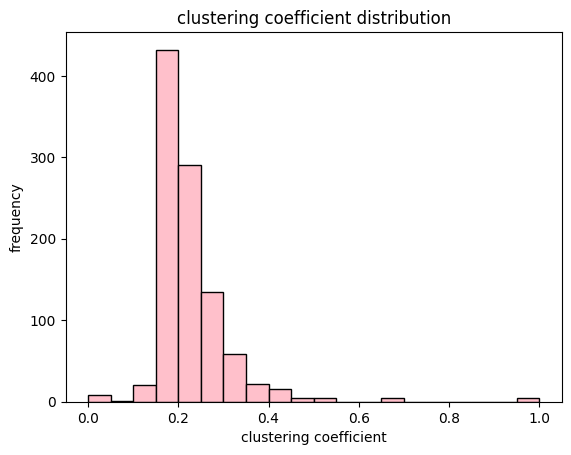

In [23]:
"""the clustering coefficient measures the degree to which nodes in a graph tend to cluster together. we use this to analyze the local clustering behavior of tokens in the fitness landscape."""

#note that these results are just for the first 1000 tokens

def compute_clustering_coefficient(G):
    clustering_coefficient = nx.clustering(G)
    return clustering_coefficient

clustering_coefficient = compute_clustering_coefficient(levenshtein_graph)
print("clustering coefficients:")
for node, coefficient in clustering_coefficient.items():
    print(f"{node}: {coefficient:.4f}")

def plot_clustering_coefficient_distribution(clustering_coefficient):
    coefficients = list(clustering_coefficient.values())
    plt.figure()
    plt.hist(coefficients, bins=20, color='pink', edgecolor='black')
    plt.title("clustering coefficient distribution")
    plt.xlabel("clustering coefficient")
    plt.ylabel("frequency")
    plt.show()

plot_clustering_coefficient_distribution(clustering_coefficient)

In [25]:
"""the smith-waterman algo is used for local sequence alignment. it finds the optimal local alignment between two sequences by identifying regions of high similarity.
unlike the needleman-wunsch algo, which performs a global alignment, the smith-waterman algorithm focuses on the most similar parts of the sequences, allowing for gaps.
essentially we measure the local similarity between different tokens by computing alignment scores."""

def smith_waterman(seq1, seq2, match=2, mismatch=-1, gap=-2):
    n = len(seq1)
    m = len(seq2)
    score = np.zeros((n + 1, m + 1))
    max_score = 0
    max_pos = None

    for i in range(1, n + 1):
        for j in range(1, m + 1):
            match_mismatch = match if seq1[i - 1] == seq2[j - 1] else mismatch
            score[i][j] = max(
                0,
                score[i - 1][j - 1] + match_mismatch,
                score[i - 1][j] + gap,
                score[i][j - 1] + gap
            )
            if score[i][j] >= max_score:
                max_score = score[i][j]
                max_pos = (i, j)

    aligned_seq1 = []
    aligned_seq2 = []
    i, j = max_pos

    while score[i][j] > 0:
        current_score = score[i][j]
        if current_score == score[i - 1][j - 1] + (match if seq1[i - 1] == seq2[j - 1] else mismatch):
            aligned_seq1.append(seq1[i - 1])
            aligned_seq2.append(seq2[j - 1])
            i -= 1
            j -= 1
        elif current_score == score[i - 1][j] + gap:
            aligned_seq1.append(seq1[i - 1])
            aligned_seq2.append('-')
            i -= 1
        elif current_score == score[i][j - 1] + gap:
            aligned_seq1.append('-')
            aligned_seq2.append(seq2[j - 1])
            j -= 1

    aligned_seq1.reverse()
    aligned_seq2.reverse()

    return ''.join(aligned_seq1), ''.join(aligned_seq2), max_score

limited_tokens = tokens[:50]

sw_scores = []
for i in range(len(limited_tokens)):
    for j in range(i + 1, len(limited_tokens)):
        aligned_seq1, aligned_seq2, max_score = smith_waterman(limited_tokens[i], limited_tokens[j])
        sw_scores.append((limited_tokens[i], limited_tokens[j], max_score))
        print(f"Smith-Waterman score between {limited_tokens[i]} and {limited_tokens[j]}: {max_score}")

print(f"calculated smith-waterman scores for {len(sw_scores)} token pairs")

Smith-Waterman score between GC and TT: 0.0
Smith-Waterman score between GC and AA: 0.0
Smith-Waterman score between GC and TC: 2.0
Smith-Waterman score between GC and AC: 2.0
Smith-Waterman score between GC and TG: 2.0
Smith-Waterman score between GC and GG: 2.0
Smith-Waterman score between GC and AG: 2.0
Smith-Waterman score between GC and GCC: 4.0
Smith-Waterman score between GC and ATC: 2.0
Smith-Waterman score between GC and ATT: 0.0
Smith-Waterman score between GC and AT: 0.0
Smith-Waterman score between GC and AAC: 2.0
Smith-Waterman score between GC and GCG: 4.0
Smith-Waterman score between GC and ACC: 2.0
Smith-Waterman score between GC and TTC: 2.0
Smith-Waterman score between GC and ATG: 2.0
Smith-Waterman score between GC and AGC: 4.0
Smith-Waterman score between GC and TGC: 4.0
Smith-Waterman score between GC and TGG: 2.0
Smith-Waterman score between GC and AGG: 2.0
Smith-Waterman score between GC and TAA: 0.0
Smith-Waterman score between GC and CC: 2.0
Smith-Waterman scor

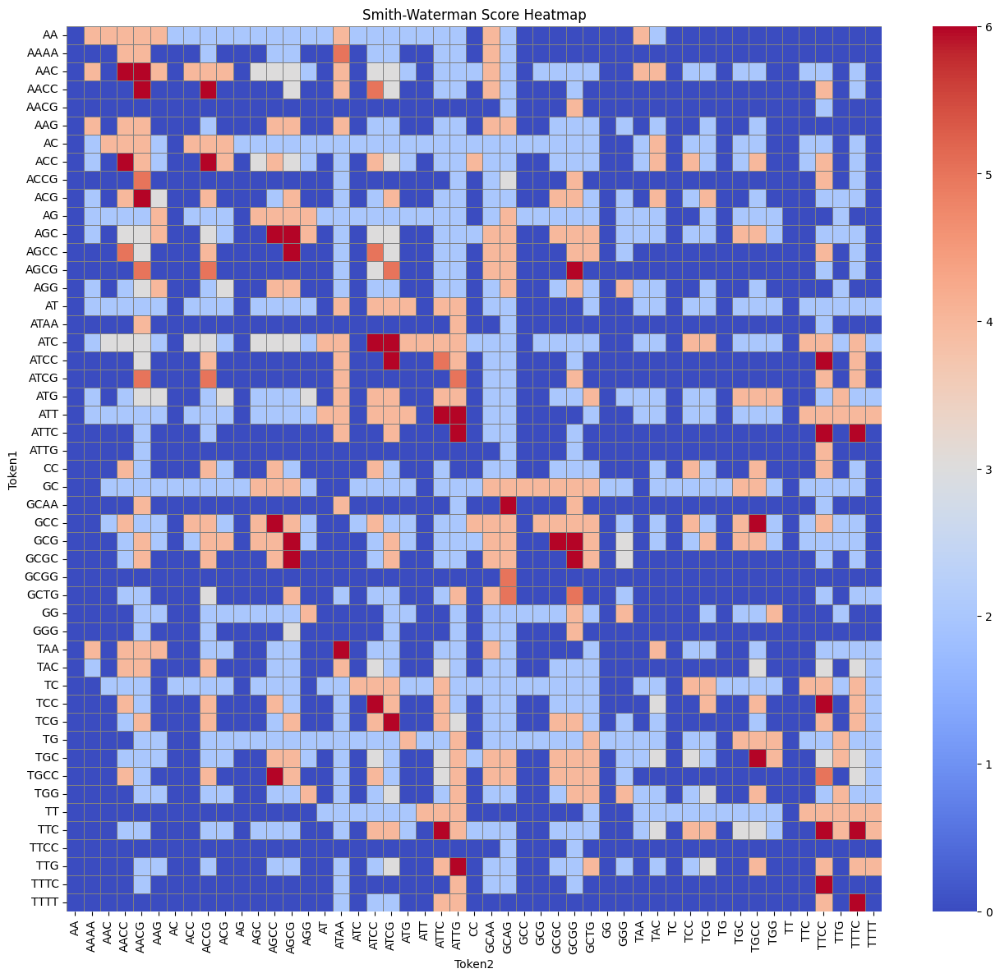

In [26]:

def plot_smith_waterman_heatmap(sw_scores, tokens):
    df = pd.DataFrame(sw_scores, columns=["Token1", "Token2", "Score"])
    pivot_table = df.pivot_table(index="Token1", columns="Token2", values="Score", fill_value=0)

    plt.figure(figsize=(16, 14))
    sns.heatmap(pivot_table, annot=False, cmap="coolwarm", cbar=True, linewidths=.5, linecolor='gray')
    plt.title("Smith-Waterman Score Heatmap")
    plt.xticks(rotation=90)
    plt.yticks(rotation=0)
    plt.show()

plot_smith_waterman_heatmap(sw_scores, limited_tokens)

In [27]:
"""the needleman wunsch algo is another algo for sequence alignment. its used to align protein or nucleotide sequences by finding the optimal match between them, allowing for gaps. 
the algo works by creating a score matrix and finding the highest scoring alignment. in our fitness landscape analysis we use
the NW algo to measure the similarity between dif tokens by computing alignment scores. """


def needleman_wunsch(seq1, seq2, match=1, mismatch=-1, gap=-1):
    # initialize the score matrix w zeros
    n = len(seq1)
    m = len(seq2)
    score = np.zeros((n + 1, m + 1))
    # fill first col with gap penalties
    for i in range(1, n + 1):
        score[i][0] = score[i - 1][0] + gap
    # fill first row w gap penalties
    for j in range(1, m + 1):
        score[0][j] = score[0][j] + gap
    # fill the rest of the score matrix
    for i in range(1, n + 1):
        for j in range(1, m + 1):
            match_mismatch = match if seq1[i - 1] == seq2[j - 1] else mismatch
            score[i][j] = max(
                score[i - 1][j - 1] + match_mismatch,
                score[i - 1][j] + gap,
                score[i][j - 1] + gap
            )
    return score[n][m]

limited_tokens = 1000

tokens = tokens[:limited_tokens]

nw_scores = []
for i in range(len(tokens)):
    for j in range(i + 1, len(tokens)):
        nw_score = needleman_wunsch(tokens[i], tokens[j])
        nw_scores.append((tokens[i], tokens[j], nw_score))
        print(f"score between {tokens[i]} and {tokens[j]}: {nw_score}")

print(f"calculated needleman-wunsch scores for {len(nw_scores)} token pairs")

score between GC and TT: -2.0
score between GC and AA: -2.0
score between GC and TC: 0.0
score between GC and AC: 0.0
score between GC and TG: -1.0
score between GC and GG: 0.0
score between GC and AG: -1.0
score between GC and GCC: 1.0
score between GC and ATC: -1.0
score between GC and ATT: -3.0
score between GC and AT: -2.0
score between GC and AAC: -1.0
score between GC and GCG: 1.0
score between GC and ACC: -1.0
score between GC and TTC: -1.0
score between GC and ATG: -1.0
score between GC and AGC: 1.0
score between GC and TGC: 1.0
score between GC and TGG: -1.0
score between GC and AGG: -1.0
score between GC and TAA: -3.0
score between GC and CC: 0.0
score between GC and ACG: -1.0
score between GC and TTG: -1.0
score between GC and AAG: -1.0
score between GC and TCC: -1.0
score between GC and TCG: -1.0
score between GC and TAC: -1.0
score between GC and TGCC: 0.0
score between GC and AAAA: -3.0
score between GC and GCGC: 1.0
score between GC and AGCC: 0.0
score between GC and GCT

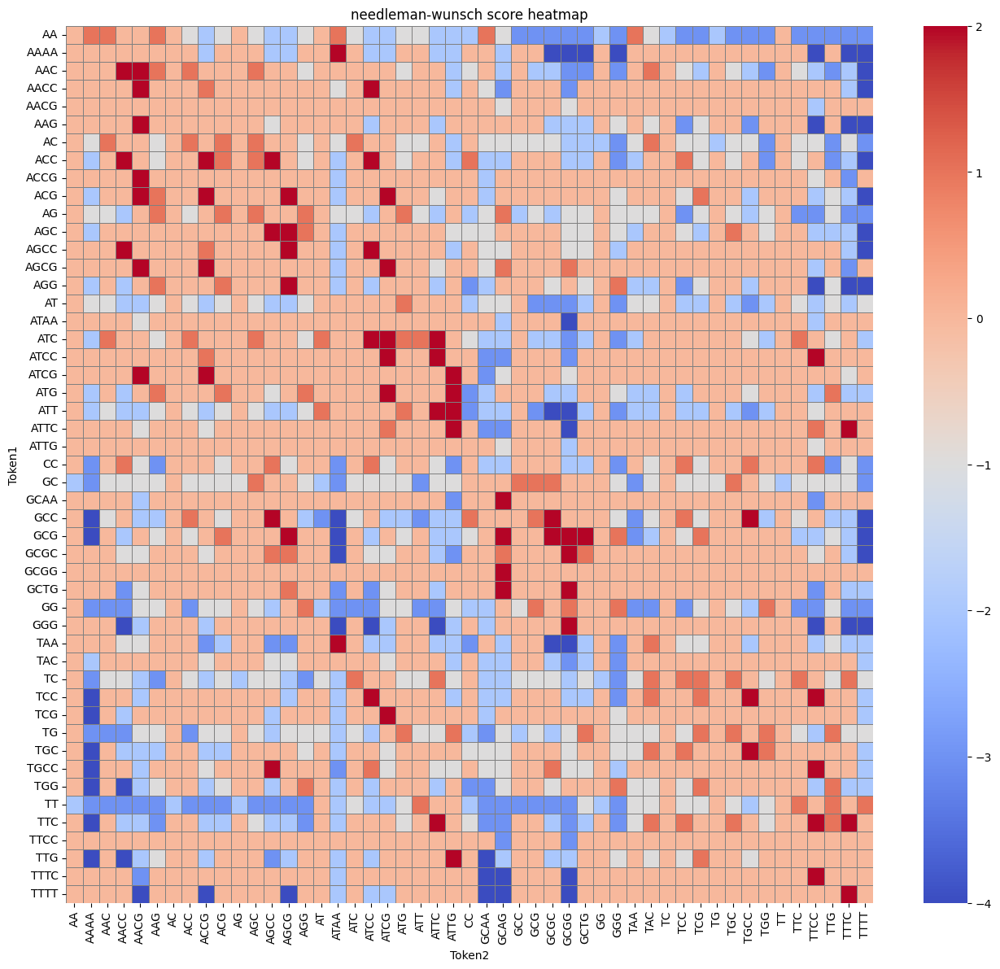

In [29]:
def plot_needleman_wunsch_heatmap(nw_scores, tokens):
    df = pd.DataFrame(nw_scores, columns=["Token1", "Token2", "Score"])
    pivot_table = df.pivot_table(index="Token1", columns="Token2", values="Score", fill_value=0)

    plt.figure(figsize=(16, 14))
    sns.heatmap(pivot_table, annot=False, cmap="coolwarm", cbar=True, linewidths=.5, linecolor='gray')
    plt.title("needleman-wunsch score heatmap")
    plt.xticks(rotation=90)
    plt.yticks(rotation=0)
    plt.show()

limited_tokens = tokens[:50] 

nw_scores = []
for i in range(len(limited_tokens)):
    for j in range(i + 1, len(limited_tokens)):
        nw_score = needleman_wunsch(limited_tokens[i], limited_tokens[j])
        nw_scores.append((limited_tokens[i], limited_tokens[j], nw_score))

plot_needleman_wunsch_heatmap(nw_scores, limited_tokens)